# Another Regression Discontinuity Confusion

Andrew Gelman gave an
[example of a Regression Discontinuity Analysis](https://statmodeling.stat.columbia.edu/2020/07/02/no-i-dont-believe-that-claim-based-on-regression-discontinuity-analysis-that/)
in which the original authors found evidence that their fit across the
two regions x < 0 and x > 0 were significantly different, and
concluded that losing a governors election cut 5-10 years off your
life.

The relevant data was
[available here](https://dataverse.harvard.edu/dataset.xhtml?persistentId=doi:10.7910/DVN/IBKYRX)
but I've downloaded it already and added it to the data directory as
"longevity.csv"

Here's the plan. We're going to discuss some mathematical concepts,
what it means to have a discontinuity for example, and then we're
going to try to identify discontinuities and fast-transitions in the
given data, as well as in synthetic data where we know an appropriate
signal is present.

Let's start by loading the data and graphing the raw data:

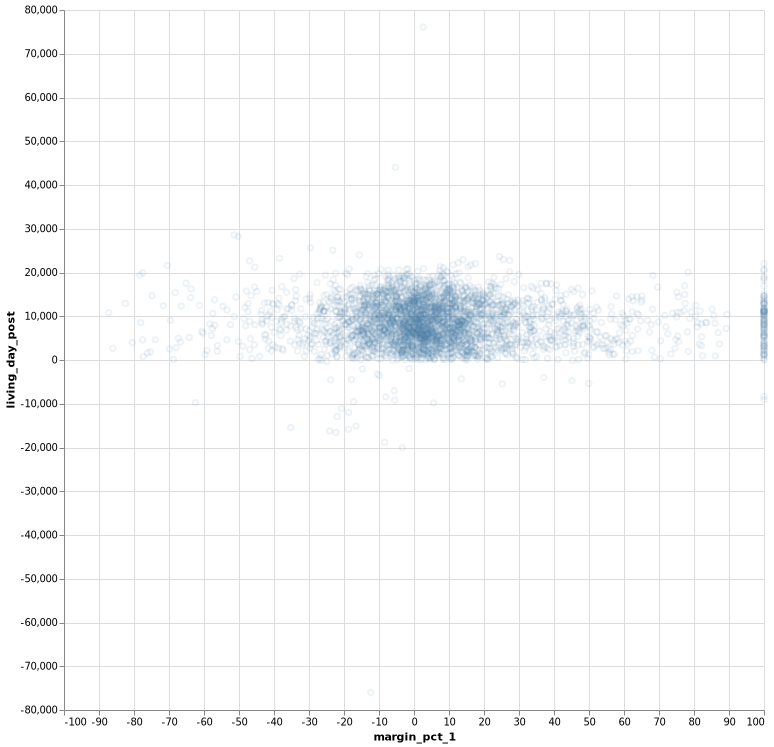

In [1]:
using Queryverse, Optim

longdf = load("data/longevity.csv") |> DataFrame

longdf |> @vlplot({:point,opacity=.1},x=:margin_pct_1,y=:living_day_post,width=700,height=700)

It would be hard to believe you could be elected *after* you died, or
that you could live many more than 70 years after being elected. Also
it seems some elections had 100% win margin... those are
suspicious. So let's just filter that stuff out for ease of
exposition. None of them seem to affect the question at hand.

At the same time we'll convert the time-scale to years.

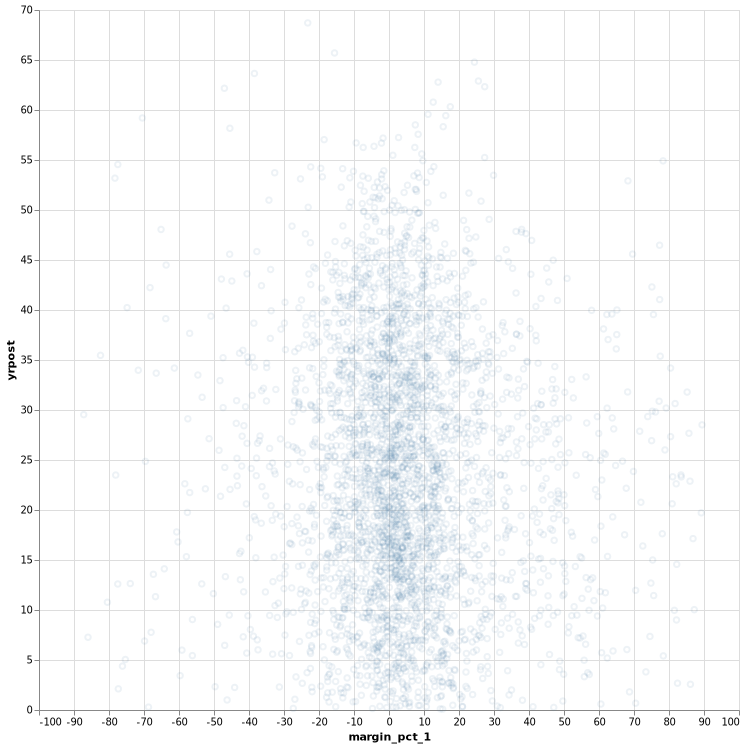

In [2]:
daypyr = 365.2422

cleandf = filter(x -> !ismissing(x.living_day_post) && !ismissing(x.margin_pct_1) && x.living_day_post > 0 && x.living_day_post < 70*daypyr && x.margin_pct_1 < 95,longdf)

cleandf.yrpost = cleandf.living_day_post/daypyr


cleandf |> @vlplot({:point,opacity=.1},x=:margin_pct_1,y=:yrpost,width=700,height=700)

## The practical concept of discontinuity...

All of the following functions are mathematically continuous:

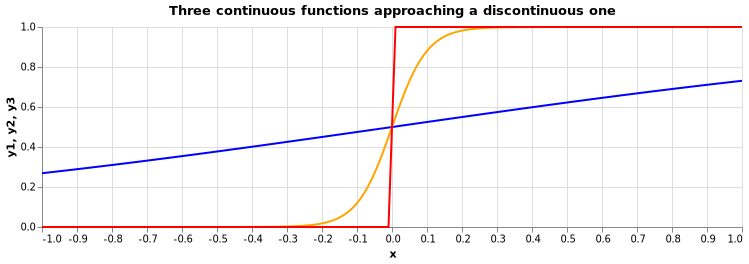

In [3]:
""" 
sigmoid(x,a,b)

A rising sigmoid function whose transition occurs at a with scale b,
evaluated in a numerically stable way so that we only ever
exponentiate negative numbers. This is a generalized "inverse_logit"
type function.

"""
function sigmoid(x,a,b) 
    s = (x-a)/b;
    if(s > 0)
        return(1.0/(1.0+exp(-s)))
    else
        return(exp(s)/(1.0+exp(s)))
    end
end
    
    


contdf = DataFrame(x=collect(-1.0:.01:1.0))
contdf.y1 = map( x-> sigmoid(x,0.0,1.0),contdf.x)
contdf.y2 = map( x-> sigmoid(x,0.0,.05),contdf.x)
contdf.y3 = map( x-> sigmoid(x,0.0,.0001),contdf.x)

contdf |> @vlplot(layers=[],width=700,title="Three continuous functions approaching a discontinuous one") + @vlplot({:line,color="blue"},x=:x,y=:y1) + 
    @vlplot({:line,color="orange"},x=:x,y=:y2) + @vlplot({:line,color="red"},x=:x,y=:y3)

Practically speaking, however, on the scale where measurements in x
resolve down to .01, the red function is in essence discontinuous
because its value changes extremely rapidly across the least possible
change in x. In other words, for a data analyst working with real
world data where all measurements have some level of discrete aspect
to them, a discontinuous function can be modeled very effectively by a
rapidly changing continuous function.

Once we have this insight, then as an analyst we can stop thinking
about whether a function is discontinuous, and instead think about
whether it changes rapidly in a local region or not. In fact, we can
work with a flexible functional form capable of representing slowly
changing or rapidly changing functions, and see if our data shows
evidence of rapid change.

There are many ways to represent nonlinear functions. One commonly
available tool is the LOESS fit. LOESS in essence fits a line or low
order polynomial (say quadratic or cubic) to a subset of the data
centered on a point of interest. It does this for many points of
interest, and forms a nonlinear function by connecting the value of
the function at these different points of interest.

How many points are involved in the fit is known as the
"bandwidth". In the VegaLite specification this bandwidth is a number
between 0 and 1 representing the fraction of the total data set that
is in use at any given fit-point.

Any flexible family of spline type functions that is capable of
detecting a rapid change in living_day_post near margin_pct_1 ~ 0 will
do for detecting whether there's an effect on longevity to winning an
election. We'll fit LOESS curves with 3 different bandwidths: 0.2,
0.1, and 0.05 graphically, using the built in LOESS function in
VegaLite plotting. As the bandwidth is decreased towards 0, the fit is
dependent only on the closest few data point, and hence can change
rapidly from one place to another when the data differs in one region
or another.

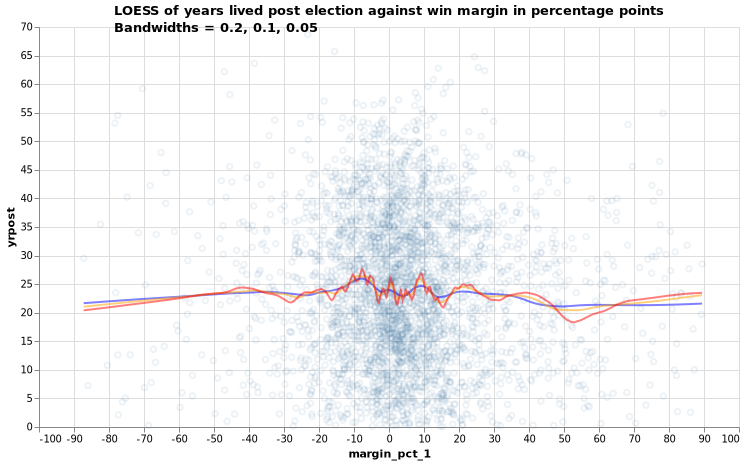

In [4]:
cleandf |> @vlplot(layer=[],width=700,height=400,title="LOESS of years lived post election against win margin in percentage points\nBandwidths = 0.2, 0.1, 0.05") + @vlplot({:point,opacity=.1},x=:margin_pct_1,y=:yrpost) + 
    @vlplot({:line,color="blue",opacity=.5},transform=[{loess=:yrpost,on=:margin_pct_1,bandwidth=.2}],x=:margin_pct_1,y=:yrpost)+
    @vlplot({:line,color="orange",opacity=.5},transform=[{loess=:yrpost,on=:margin_pct_1,bandwidth=.1}],x=:margin_pct_1,y=:yrpost)+
    @vlplot({:line,color="red",opacity=.5},transform=[{loess=:yrpost,on=:margin_pct_1,bandwidth=.05}],x=:margin_pct_1,y=:yrpost)

What this shows is: nothing. As the LOESS fit uses less and less data
due to the reducing bandwidth, we find not that there's a
discontinuous jump in the function, rather there's simply small scale
oscillations up and down which are consistent with more and more noisy
fit. The blue curve which smoothes through the noise appears more
reasonable as an estimate of what to expect than the red curve which
rapidly changes up and down. Any causal model which somehow explains
longevity of candidates by saying that winning by 0.1 percentage
points does nothing to your longevity but by 0.2 percentage points
increases your longevity vs 0.1 by 4 years, while 0.3 percentage
points decreases your longevity vs 0.1 by 2 years is going to have a
lot of explaining to do. On the other hand, the explanation "this
estimate is noisy and there is no evidence of any meaningful effect"
works just fine.

Of course this is the raw data. If we believe the referenced analysis,
it just so happens that the people who won the election must have been
much sicker, so that by winning the election, their lifespan was
extended 5 to 10 years thereby just exactly canceling out the effect
of them being much sicker.

🤔

What does it look like when there's a real signal? Let's put a few
signals in place. First we'll just reuse the x values so that the
distribution of x values is the same as our analysis. Then we'll
create pure Normally distributed noise with an appropriate
scale... and add in a signal, which will be plotted in blue. The red
LOESS line will be our estimate.

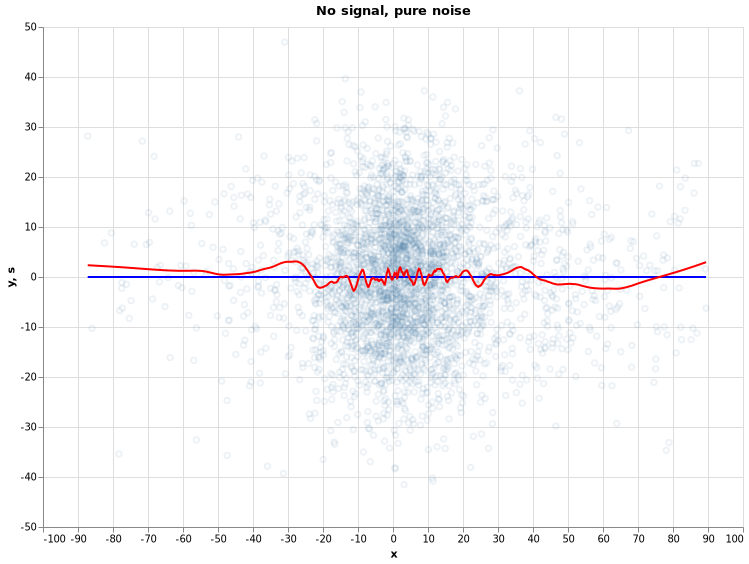

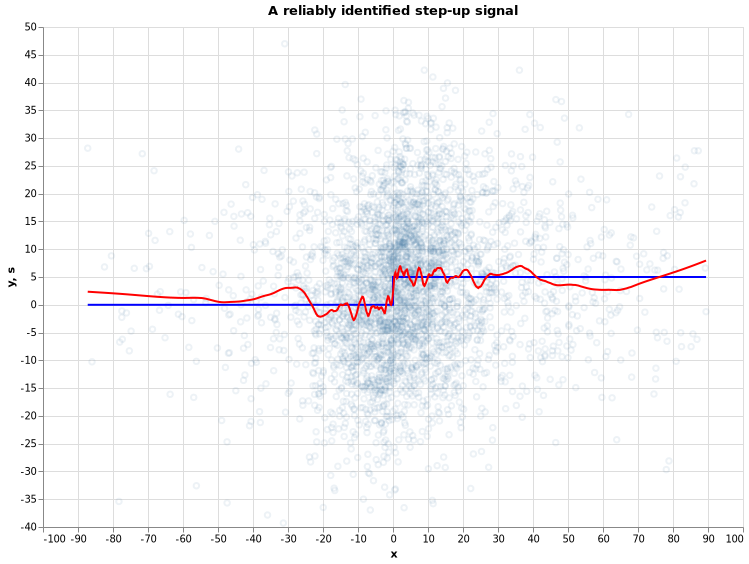

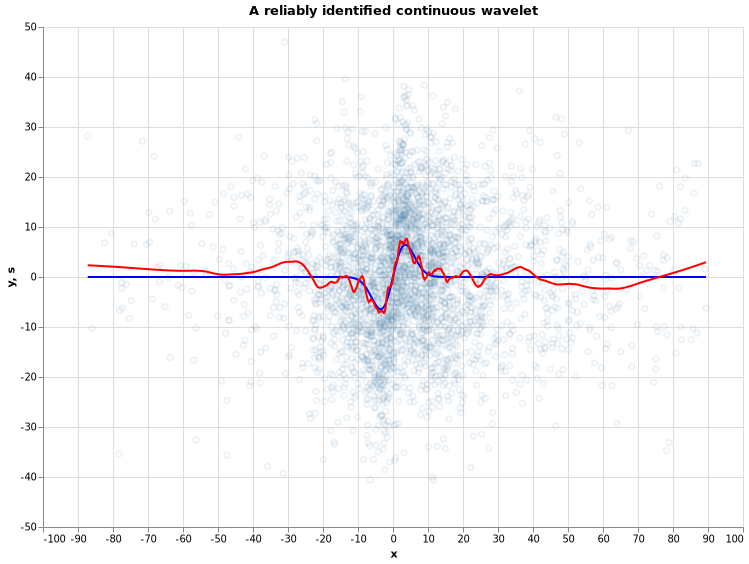

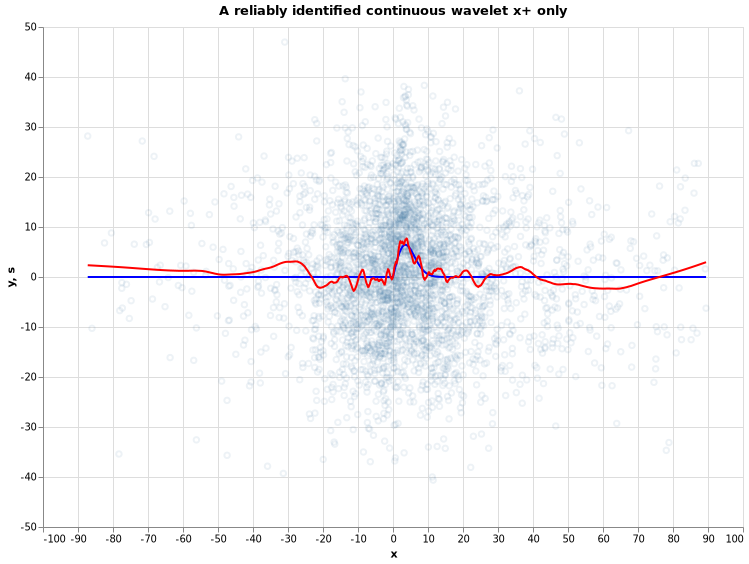

In [5]:
using Distributions, Random


n = nrow(cleandf)
Random.seed!(123)
sdy = std(cleandf.living_day_post/daypyr)


#xvals = rand(Normal(meanx,sdx),n)
xvals = cleandf.margin_pct_1
ynoise = rand(Normal(0,sdy),n)
ysig = [if(xvals[i] > 0) 5.0 else 0.0 end for i in eachindex(ynoise)]


function plotsig(x,y,n,lab)
    spec = DataFrame(x=x,y=y+n,s=y) |> @vlplot(layers=[],width=700,height=500,title=lab)+
        @vlplot({:point,opacity=.1},x=:x,y=:y) +    
    @vlplot({:line,opacity=1,color="blue"},x=:x,y=:s)+
    @vlplot({:line,color="red"},transform=[{loess=:y,on=:x,bandwidth=.05}],x=:x,y=:y);
    return(spec);
end


p0 = plotsig(xvals,zeros(n),ynoise,"No signal, pure noise");
display(p0)


p1 = plotsig(xvals,ysig,ynoise,"A reliably identified step-up signal");
display(p1);

ysig2 = [3*xvals[i]*exp(-(xvals[i]/5)^2) for i in eachindex(ynoise)]

p2=plotsig(xvals,ysig2,ynoise,"A reliably identified continuous wavelet");
display(p2)

ysig3 = [ if(xvals[i] > 0) 3*xvals[i]*exp(-(xvals[i]/5)^2) else 0.0 end for i in eachindex(ynoise)]

p3 = plotsig(xvals,ysig3,ynoise,"A reliably identified continuous wavelet x+ only");
display(p3)

The LOESS methodology using 5% of the data as bandwidth and a similar
number of raw data points clearly identifies the signal in each
case. 

We conclude that if there were a signal in the raw data from this
study, it would be fairly strongly visible in the LOESS with 5%
bandwidth rather than oscillating wildly around zero on short "time
scales" (in this case vote percentage scale). The reason we can
conclude this is in essence that a true signal couldn't oscillate
rapidly, as once we transitioned across the x=0 boundary, there's
nothing really causally different between people who won by 0.1
percentage points, and people who won by say 0.15 or 0.2 percentage
points.